In [1]:
import numpy as np
import pandas as pd
from tabulate import tabulate

from model_output_eval import load_complete_split_reddit_data, load_limited_split_data 

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
train_art_df, val_art_df, eval_art_df, train_tld_cmt_df, val_tld_cmt_df, eval_tld_cmt_df =  load_complete_split_reddit_data("artsplit", return_eval=True)

combined_art_df = pd.concat([train_art_df, val_art_df, eval_art_df], ignore_index=True)
combined_tld_cmt_df = pd.concat([train_tld_cmt_df, val_tld_cmt_df, eval_tld_cmt_df], ignore_index=True)

print(len(combined_art_df))
print(len(combined_tld_cmt_df))

print(combined_art_df.info)
print(combined_tld_cmt_df.info)

print(combined_art_df.columns)
print(combined_tld_cmt_df.columns)

217
14462
<bound method DataFrame.info of      Unnamed: 0  Column1                                         article_id  \
0             0      190  99d319d8d7aed0d78dd74b23a1bb077539f4ad4a6ec9bd...   
1             1      264  a712bbed112bfd50f806df4ee184928adde406fee8713b...   
2             2      694  ec6950e4738a52f153382ef5921a5a769042fdbd47c85d...   
3             3      300  5ed44948663019a59ea6b59cab64bee62d6ffa7c750bdc...   
4             4     1248  02dcb8cb079fe6bf93b3855762205be5be8f5b48d9f3cd...   
..          ...      ...                                                ...   
212          18      572  dd3b5b2b2d36499545c7cdfe0c111cf7cdf1a3bee52e81...   
213          19       49  0a9c1f1a54aed7e0815c4e989a407ea7c2e936a54df73f...   
214          20      187  aaad5661ac50093e6a0790d531c3464c13d361acd43931...   
215          21      387  b972662fbfd73eaeeeee753c96a04b926d93dbc42ba20e...   
216          22      980  f8eca7d89ea55152983e30be170230cd4a1d8dfd5e83c4...   

    artic

In [3]:
# Cumulative comment counts
threshold_list = [30,35, 40,45, 50, 70, 90, 100,120]

#-----------------#
combined_art_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\destilled\\r_all_articles_complete_preprocessed.csv"
combined_art_df = pd.read_csv(combined_art_filepath, sep=";")

combined_cmt_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\destilled\\r_all_comments_complete_preprocessed.csv"
combined_cmt_df = pd.read_csv(combined_cmt_filepath, sep=";").sort_values(by=['article_id', 'level', 'date'], ascending=[True, True, True])
combined_tld_cmt_df = combined_cmt_df[combined_cmt_df['level'] == 0]
#v-----------------#

print(len(combined_art_df))

num_art_per_threshold = []
num_tld_cmt_per_threshold = []
for threshold in threshold_list:
    filtered_art_df = combined_art_df[combined_art_df["num_tld_comments"] >= threshold] 
    num_art_per_threshold.append(len(filtered_art_df))
    num_tld_cmt_per_threshold.append(filtered_art_df["num_tld_comments"].sum())
    
print("For threshold {} there are: \n\t - {} articles \n\t - {} comments".format(threshold_list, num_art_per_threshold, num_tld_cmt_per_threshold))
print(np.multiply(np.array(num_art_per_threshold), np.array(threshold_list)))

217
For threshold [30, 35, 40, 45, 50, 70, 90, 100, 120] there are: 
	 - [159, 140, 123, 107, 91, 63, 50, 37, 28] articles 
	 - [13207, 12601, 11971, 11296, 10549, 8850, 7824, 6581, 5590] comments
[4770 4900 4920 4815 4550 4410 4500 3700 3360]


### Data visualization

Text(0, 0.5, 'Comment sample index')

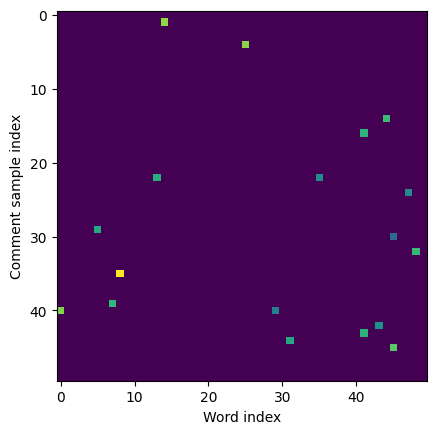

In [4]:

from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.pipeline import Pipeline

txt_prep_pipeline = Pipeline([
('vect', CountVectorizer()),
('tfidf', TfidfTransformer()),
])
    

txt_prep_pipeline.fit(combined_tld_cmt_df["body"])

encoded_tld_cmts = txt_prep_pipeline.transform(train_tld_cmt_df["body"]).toarray()


import matplotlib.pyplot as plt

encoded_tld_cmts = np.resize(encoded_tld_cmts, (50, 50))

plt.imshow(encoded_tld_cmts, interpolation='nearest')
plt.xlabel("Word index")
plt.ylabel("Comment sample index")
#plt.colorbar()


Text(0, 0.5, 'Cumulative number of comments')

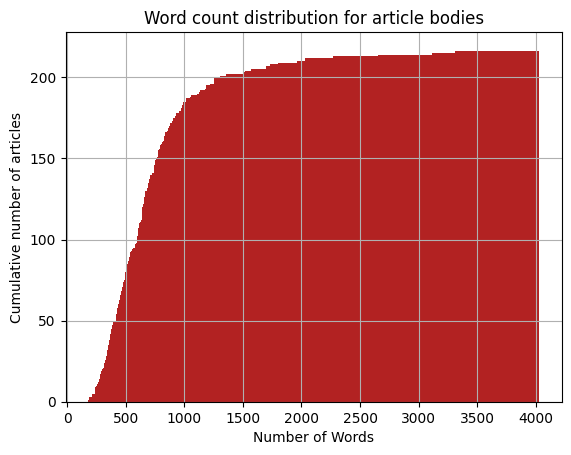

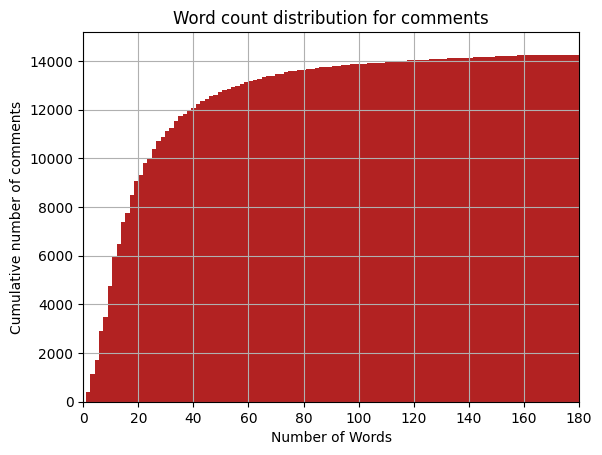

In [5]:
# Plot word count histograms

#Articles
seq_len = [len(art_body.split()) for art_body in combined_art_df["body"]]
plt.figure()
pd.Series(seq_len).hist(bins = 1000,color='firebrick', cumulative=True)
plt.title('Word count distribution for article bodies')
plt.xlabel('Number of Words')
#plt.xlim(0, 350)
plt.ylabel('Cumulative number of articles')

#Comments
seq_len = [len(cmt_body.split()) for cmt_body in combined_tld_cmt_df["body"]]
plt.figure()
pd.Series(seq_len).hist(bins = 1000,color='firebrick', cumulative=True)
plt.title('Word count distribution for comments')
plt.xlabel('Number of Words')
plt.xlim(0, 180)
plt.ylabel('Cumulative number of comments')


Index(['Column1', 'article_id', 'article_type', 'from_where', 'link',
       'post_id', 'posted_by', 'date_posted', 'post_title', 'post_body',
       'date', 'author', 'headline', 'body', 'char_count', 'comments_ids',
       'num_tld_comments', 'selected'],
      dtype='object')


Text(0, 0.5, 'Cumulative number of articles')

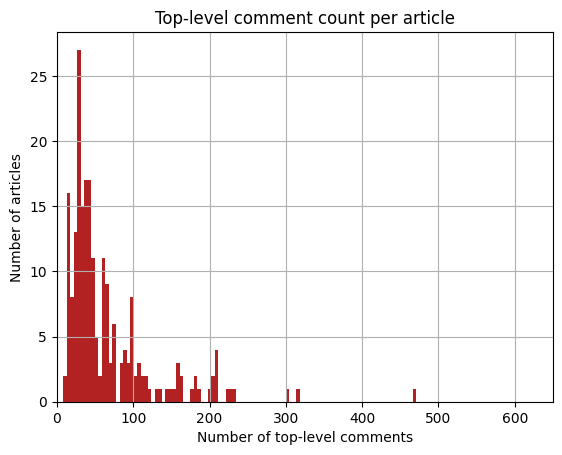

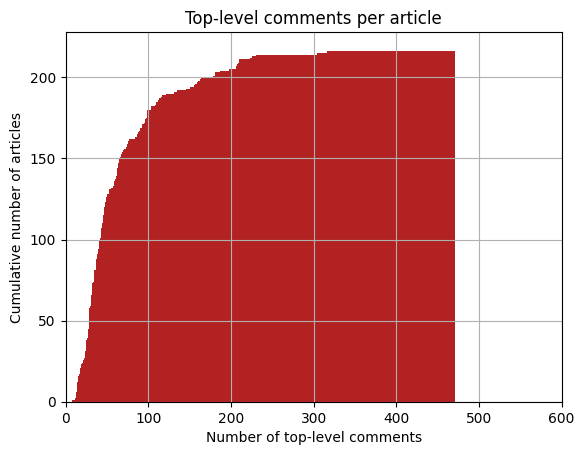

In [6]:
print(combined_art_df.columns)

plt.figure()
combined_art_df["num_tld_comments"].hist(bins = 100,color='firebrick')
plt.title('Top-level comment count per article')
plt.xlabel('Number of top-level comments')
plt.xlim(0, 650)
plt.ylabel('Number of articles')

plt.figure()
#weights = np.ones_like(combined_art_df["num_tld_comments"])/float(len(combined_art_df["num_tld_comments"]))
combined_art_df["num_tld_comments"].hist(bins = 1000,color='firebrick', cumulative=True) #, weights=weights)
plt.title('Top-level comments per article')
plt.xlabel('Number of top-level comments')
plt.xlim(0, 600)
plt.ylabel('Cumulative number of articles')



In [7]:
# Get the top 10 subreddits for articles with comments
top_art_subreddits = combined_art_df["from_where"].value_counts().head(10)
top_tld_cmt_subreddits = combined_tld_cmt_df["from_where"].value_counts().head(10)

print(top_art_subreddits, len(top_art_subreddits))
print(top_tld_cmt_subreddits, len(top_tld_cmt_subreddits))

print("---- Latex Table ----")

tab_top_art_data_collection = []
for item_name, item_count in top_art_subreddits.items():
    tab_top_art_data_collection.append([item_name, np.round(100*top_art_subreddits[item_name] / top_art_subreddits.sum(), 2)])

latex_top_art_tab_data_kwargs = {"tabular_data": tab_top_art_data_collection, "headers": ["Subreddit Name", "Article Proportion (%)"]}

print( tabulate(tablefmt="latex",
                **latex_top_art_tab_data_kwargs
                )) 


tab_top_tld_cmt_data_collection = []
for item_name, item_count in top_tld_cmt_subreddits.items():
    tab_top_tld_cmt_data_collection.append([item_name, np.round(100*top_tld_cmt_subreddits[item_name] / top_tld_cmt_subreddits.sum(), 2)])

latex_top_tld_cmt_tab_data_kwargs = {"tabular_data": tab_top_tld_cmt_data_collection, "headers": ["Subreddit Name", "Comment Proportion (%)"]}

print( tabulate(tablefmt="latex",
                **latex_top_tld_cmt_tab_data_kwargs
                ))


from_where
r/science           66
r/Futurology        44
r/technology        28
r/technews          17
r/worldnews         13
r/CryptoCurrency    11
r/Physics            6
r/space              5
r/tech               5
r/programming        4
Name: count, dtype: int64 10
from_where
r/science           4729
r/Futurology        3016
r/technology        1531
r/technews          1368
r/worldnews         1216
r/gadgets            476
r/CryptoCurrency     372
r/space              342
r/tech               328
r/Physics            253
Name: count, dtype: int64 10
---- Latex Table ----
\begin{tabular}{lr}
\hline
 Subreddit Name   &   Article Proportion (\%) \\
\hline
 r/science        &                    33.17 \\
 r/Futurology     &                    22.11 \\
 r/technology     &                    14.07 \\
 r/technews       &                     8.54 \\
 r/worldnews      &                     6.53 \\
 r/CryptoCurrency &                     5.53 \\
 r/Physics        &                     3.02 \\

In [8]:
# Get the top 10 most active commenters 
print(combined_tld_cmt_df["username"].value_counts().head(10))

username
OliverSparrow         24
coinfeeds-bot          9
doctorcrimson          8
autotldr               8
grumpyfrench           7
sometimesijustdont     6
Black_RL               6
herbw                  6
dangil                 6
TalkingBackAgain       6
Name: count, dtype: int64


In [9]:
# Top 10 hostnames for article URLs
import re 

get_hostname = lambda url: re.sub( 'www.', '', url.split("/")[2]) 

hostnames = [get_hostname(link_url) for link_url in combined_art_df["link"]]

top_hostname_counts = pd.Series(hostnames).value_counts().head(30)

tab_top_hostname_data_collection = []
for tab_row in range(int(len(top_hostname_counts)/2)):
    tab_top_hostname_data_collection.append([top_hostname_counts.index[tab_row], 
                                            top_hostname_counts[tab_row],
                                            top_hostname_counts.index[tab_row+15],
                                            top_hostname_counts[tab_row+15],
                                            ])  
latex_top_hostname_tab_data_kwargs = {"tabular_data": tab_top_hostname_data_collection, "headers": ["Hostname", "Number of articles", "Hostname", "Number of Articles"]}

print( tabulate(tablefmt="latex",
                **latex_top_hostname_tab_data_kwargs
                ))

print(top_hostname_counts, len(top_hostname_counts))

\begin{tabular}{lrlr}
\hline
 Hostname               &   Number of articles & Hostname             &   Number of Articles \\
\hline
 phys.org               &                   13 & sciencenews.org      &                    4 \\
 sciencealert.com       &                   10 & cnet.com             &                    3 \\
 newscientist.com       &                    8 & thenextweb.com       &                    3 \\
 zdnet.com              &                    7 & space.com            &                    3 \\
 eurekalert.org         &                    7 & astronomy.com        &                    3 \\
 arstechnica.com        &                    7 & engadget.com         &                    3 \\
 technologyreview.com   &                    6 & newatlas.com         &                    3 \\
 scientificamerican.com &                    6 & abc.net.au           &                    2 \\
 futurism.com           &                    5 & cointelegraph.com    &                    2 \\
 tom

Text(0, 0.5, 'Number of comments')

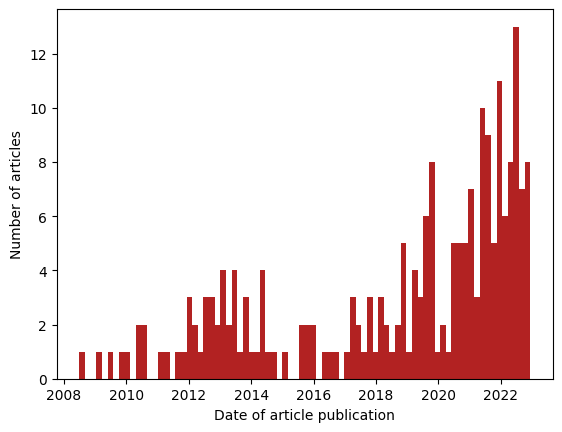

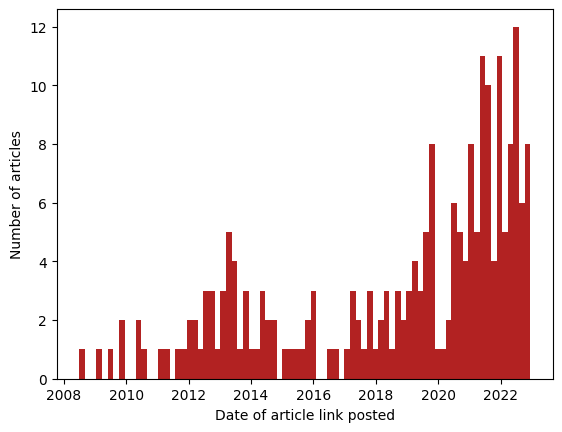

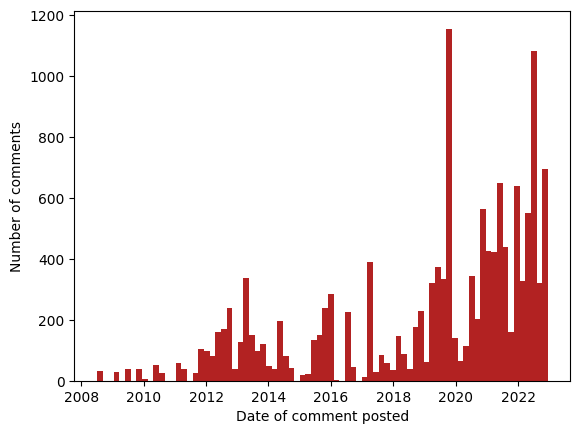

In [10]:
# Plot date histograms for articles:

from datetime import datetime

publish_dates = [datetime.strptime(str(date_str), "%Y-%m-%d") for date_str in combined_art_df["date"].values]
#publish_dates = np.array([pd for pd in publish_dates if pd.year > 2000]])
publish_dates = [pd for pd in publish_dates if pd.year!=2023] # Remove date with year 2023 since those might be errors and are improbable to have produced the min. number of comments = 25
publish_dates = np.array(publish_dates)


plt.figure()
plt.hist(publish_dates, bins = 80,color='firebrick')
plt.xlabel("Date of article publication")
plt.ylabel("Number of articles")

# Plot date histograms for posts: (date_posted)

posted_dates = [datetime.fromtimestamp(int(float(timestamp[1:-1]))) for timestamp in combined_art_df["date_posted"].values]
posted_dates = [pd for pd in posted_dates if pd.year!=2023] # Remove date with year 2023 since those might be errors and are improbable to have produced the min. number of comments = 25
posted_dates = np.array(posted_dates)

plt.figure()
plt.hist(posted_dates, bins = 80,color='firebrick')
plt.xlabel("Date of article link posted")	
plt.ylabel("Number of articles")


# Plot date histograms for comments:
cmt_posted_dates = [datetime.fromtimestamp(int(float(timestamp))) for timestamp in combined_tld_cmt_df["date"].values]
cmt_posted_dates= [cpd for cpd in cmt_posted_dates if cpd.year!=2023] # Remove date with year 2023 since those might be errors and are improbable to have produced the min. number of comments = 25
cmt_posted_dates= np.array(cmt_posted_dates)

plt.figure()
plt.hist(cmt_posted_dates, bins = 80,color='firebrick')
plt.xlabel("Date of comment posted")
plt.ylabel("Number of comments")

https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 20:36:52 2021-12-15 00:00:00
-509 days, 20:36:52 -509 0.8589351851851852
https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 21:22:00 2021-12-15 00:00:00
-509 days, 21:22:00 -509 0.8902777777777777
https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 21:27:09 2021-12-15 00:00:00
-509 days, 21:27:09 -509 0.8938541666666666
https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 21:35:43 2021-12-15 00:00:00
-509 days, 21:35:43 -509 0.8998032407407407
https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 21:44:30 2021-12-15 00:00:00
-509 days, 21:44:30 -509 0.9059027777777777
https://www.washingtonpost.com/technology/2020/07/23/us-plan-quantum-internet/
2020-07-24 21:51:07 2021-12-15 00:00:00
-509 days, 21:51:07 -509 0.9104976851851851
https://www.washington

Text(0, 0.5, 'Number of comments')

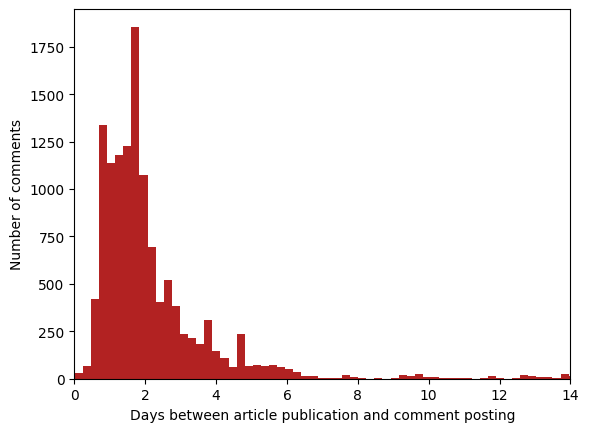

In [11]:
# Plot histogram of duration between article publication and comment posting

date_diffs = []
for row_idx, artdf_row in combined_art_df.iterrows():
    if datetime.strptime(str(artdf_row["date"]), "%Y-%m-%d").year != 2023:	#Exclude from statistics. Might be inaccurate by incomplete months or zear.
        filtered_cmt_dates = combined_tld_cmt_df[combined_tld_cmt_df["article_id"] == artdf_row["article_id"]]
        
        art_date_diffs = []
        for timestamp in filtered_cmt_dates["date"].values:
            art_cmt_timedelta = (datetime.fromtimestamp(int(float(timestamp))) - datetime.strptime(str(artdf_row["date"]), "%Y-%m-%d"))
            art_cmt_date_diff = art_cmt_timedelta.days + (art_cmt_timedelta.seconds/(3600*24))
            if art_cmt_date_diff < 0: #Exclude articles with, apparently, wrong date )e.g. if the article was updated = new date was parsed
                print(artdf_row["link"])
                print(datetime.fromtimestamp(int(float(timestamp))), datetime.strptime(str(artdf_row["date"]), "%Y-%m-%d")  )
                print(art_cmt_timedelta, art_cmt_timedelta.days, art_cmt_timedelta.seconds/(3600*24))
            else:
                art_date_diffs.append(art_cmt_date_diff)
        date_diffs.extend(art_date_diffs)       
                            
print(np.max(date_diffs))
plt.hist(date_diffs, bins = 10000,color='firebrick')
plt.xlim(0, 14)
plt.xlabel("Days between article publication and comment posting")
plt.ylabel("Number of comments")



https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:04:17 2021-12-16 12:17:31
-1 day, 5:46:46 -1 0.24081018518518518
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:04:37 2021-12-16 12:17:31
-1 day, 5:47:06 -1 0.24104166666666665
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:10:39 2021-12-16 12:17:31
-1 day, 5:53:08 -1 0.2452314814814815
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:12:13 2021-12-16 12:17:31
-1 day, 5:54:42 -1 0.24631944444444445
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:16:04 2021-12-16 12:17:31
-1 day, 5:58:33 -1 0.24899305555555556
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:19:18 2021-12-16 12:17:31
-1 day, 6:01:47 -1 0.25123842592592593
https://www.sciencenews.org/a

Text(0, 0.5, 'Number of comments')

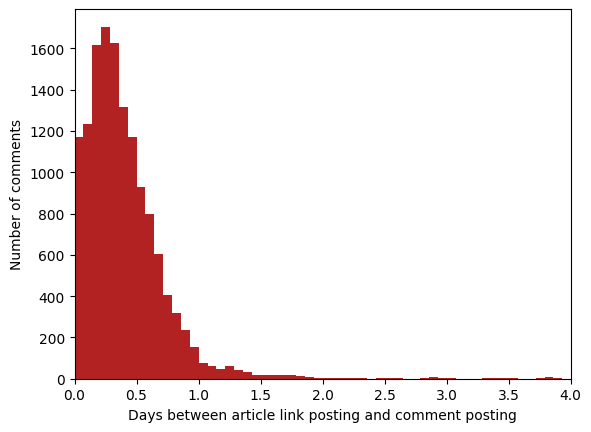

In [12]:
# Plot histogram of duration between article link posting and comment posting

date_diffs = []
for row_idx, artdf_row in combined_art_df.iterrows():
    if datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))).year != 2023:	#Exclude from statistics. Might be inaccurate by incomplete months or zear.
        filtered_cmt_dates = combined_tld_cmt_df[combined_tld_cmt_df["article_id"] == artdf_row["article_id"]]
        
        art_date_diffs = []
        for timestamp in filtered_cmt_dates["date"].values:
            art_cmt_timedelta = (datetime.fromtimestamp(int(float(timestamp))) - datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))))
            art_cmt_date_diff = art_cmt_timedelta.days + (art_cmt_timedelta.seconds/(3600*24))
            if art_cmt_date_diff < 0: #Exclude articles with, apparently, wrong date )e.g. if the article was updated = new date was parsed
                print(artdf_row["link"])
                print(datetime.fromtimestamp(int(float(timestamp))), datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))) )
                print(art_cmt_timedelta, art_cmt_timedelta.days, art_cmt_timedelta.seconds/(3600*24))
            else:                
                art_date_diffs.append(art_cmt_date_diff)
        date_diffs.extend(art_date_diffs)       
                            
print(np.max(date_diffs))
plt.hist(date_diffs, bins = 10000, color='firebrick')
plt.xlim(0, 4)
plt.xlabel("Days between article link posting and comment posting")
plt.ylabel("Number of comments")



# Plot histogram of duration between article publication and link posting

https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:04:17 2021-12-16 12:17:31
-1 day, 5:46:46 -1 0.24081018518518518
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:04:37 2021-12-16 12:17:31
-1 day, 5:47:06 -1 0.24104166666666665
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:10:39 2021-12-16 12:17:31
-1 day, 5:53:08 -1 0.2452314814814815
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:12:13 2021-12-16 12:17:31
-1 day, 5:54:42 -1 0.24631944444444445
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:16:04 2021-12-16 12:17:31
-1 day, 5:58:33 -1 0.24899305555555556
https://www.sciencenews.org/article/quantum-physics-imaginary-numbers-math-reality
2021-12-15 18:19:18 2021-12-16 12:17:31
-1 day, 6:01:47 -1 0.25123842592592593
https://www.sciencenews.org/a

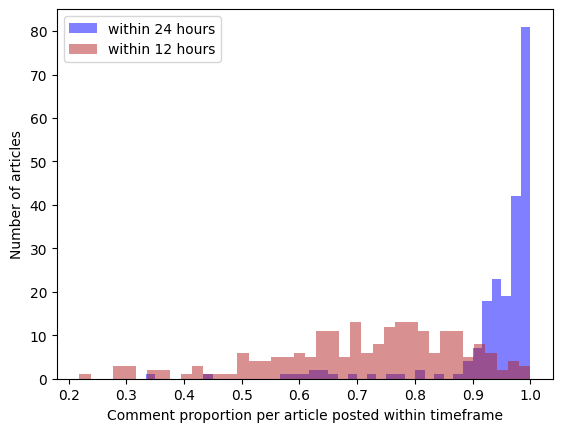

In [13]:
#Provokative articles; Plot histogram of average duration between article publication and comment posting

# Plot histogram of duration between article publication and comment posting

halfday_prop = []
oneday_prop = []
for row_idx, artdf_row in combined_art_df.iterrows():
    if datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))).year != 2023:	#Exclude from statistics. Might be inaccurate by incomplete months or zear.
        filtered_cmt_dates = combined_tld_cmt_df[combined_tld_cmt_df["article_id"] == artdf_row["article_id"]]
        
        art_date_diffs = []
        for timestamp in filtered_cmt_dates["date"].values:
            art_cmt_timedelta = (datetime.fromtimestamp(int(float(timestamp))) - datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))))
            art_cmt_date_diff = art_cmt_timedelta.days + (art_cmt_timedelta.seconds/(3600*24))
            if art_cmt_date_diff < 0: #Exclude articles with, apparently, wrong date )e.g. if the article was updated = new date was parsed
                print(artdf_row["link"])
                print(datetime.fromtimestamp(int(float(timestamp))), datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))) )
                print(art_cmt_timedelta, art_cmt_timedelta.days, art_cmt_timedelta.seconds/(3600*24))
            else:
                art_date_diffs.append(art_cmt_date_diff)
        if len(art_date_diffs) > 0:
            halfday_prop.append(np.sum(np.array(art_date_diffs) < 0.5)/len(art_date_diffs))       
            oneday_prop.append(np.sum(np.array(art_date_diffs) < 1.0)/len(art_date_diffs))       
                            
plt.hist(oneday_prop, bins = 40,color='blue', label="within 24 hours", alpha=0.5)#weights=np.ones(len(oneday_prop)) / len(oneday_prop))
plt.hist(halfday_prop, bins = 40,color='firebrick', label="within 12 hours", alpha=0.5)# weights=np.ones(len(halfday_prop)) / len(halfday_prop))

#plt.xlim(0, 1)
plt.xlabel("Comment proportion per article posted within timeframe")
plt.ylabel("Number of articles")
plt.legend()


217


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


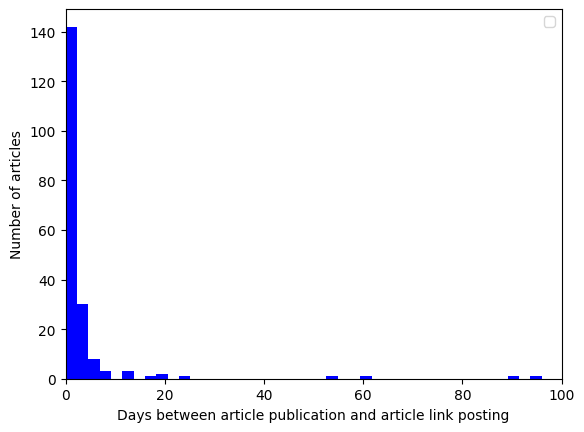

In [14]:
#Provokative articles; Plot histogram of average duration between article publication and comment posting

# Plot histogram of duration between article publication and comment posting
date_diffs = []
print(len(combined_art_df))
for row_idx, artdf_row in combined_art_df.iterrows():
    if datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))).year != 2023:	#Exclude from statistics. Might be inaccurate by incomplete months or zear.
        
        art_timedelta = (datetime.fromtimestamp(int(float(artdf_row["date_posted"][1:-1]))) -datetime.strptime(str(artdf_row["date"]), "%Y-%m-%d"))
        art_c_date_diff = art_timedelta.days + (art_timedelta.seconds/(3600*24))
            
        if art_c_date_diff >= 0:
            date_diffs.append(art_c_date_diff)
                        
plt.hist(date_diffs, bins = 1000,color='blue')
plt.xlim(0, 100)
plt.xlabel("Days between article publication and article link posting")
plt.ylabel("Number of articles")
plt.legend()


#### Analysing content & Topics

In [15]:
#!pip install seaborn spacy --user
#!python -m spacy download en_core_web_md
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import spacy
import pyLDAvis.gensim_models
pyLDAvis.enable_notebook()# Visualise inside a notebook

from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaMulticore
from gensim.models import CoherenceModel

In [16]:
def init_spacy_model(doc_str_list, truncate_dict = False):
   # Our spaCy model:
   nlp = spacy.load('en_core_web_md')
   #nlp = en_core_web_md.load() # Tags I want to remove from the text

   rm_token_types= ['SCONJ','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'AUX']   
   #rm_token_types= ['SCONJ','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'AUX', 'VERB', 'ADV']
   
   #rm_token_types= ['SCONJ','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'AUX', 'VERB', 'ADV', 'SCONJ', 'NOUN','X', 'PROPN']
   
   # Reminder of the token types:
   # SCONJ = subordinating conjunctions, e.g. "if", "while", "because", "since", "although", "until", "unless", "whereas", "after", "so", "though", "because", "since", "unless"
   # PRON = pronouns, e.g. "I", "you", "he", "she", "it", "we", "they"
   # CCONJ = coordinating conjunctions, e.g. "and", "or", "but"
   # PUNCT = punctuation, e.g. ".", ",", ";", "!"
   # PART = particles, e.g. "not", "yes", "no", "up", "down", "off", "out", "over", "under", "again", "further", "then", "once", "here", "there", "when", "where", "why", "how", "all", "any", "both", "each", "few", "more", "most", "other", "some", "such", "no", "nor", "not", "only", "own", "same", "so", "than", "too", "very", "s", "t", "can", "will", "just", "don", "should", "now"
   # DET = determiners, e.g. "the", "a", "an"
   # ADP = adpositions, e.g. "in", "to", "at", "with"
   # SPACE = space, e.g. " "
   # NUM = numbers, e.g. "1", "2", "3", "4", "5", "6", "7", "8", "9", "0"
   # SYM = symbols, e.g. "$", "%", "&", "(", ")", "*", "+", ",", "-", ".", "/", ":", ";", "<", "=", ">", "?", "@", "[", "\\", "]", "^", "_", "`", "{", "|", "}", "~"
   # AUX = auxiliary verbs, e.g. "is", "was", "will", "should", "would", "could", "do", "does", "did", "have", "has", "had", "may", "might", "must", "need", "ought", "shall", "should", "will", "would"
   
   # ADV = adverbs, e.g. "very", "quickly", "slowly"
   # VERB = verbs, e.g. "is", "was", "will", "should", "would", "could", "do", "does", "did", "have", "has", "had", "may", "might", "must", "need", "ought", "shall", "should", "will", "would"

   # NOUN = nouns, e.g. "cat", "dog", "house", "tree", "car", "boat"

   # PROPN = proper nouns, e.g. "London", "Paris", "John", "Mary", "Donald Trump"
   # INTJ = interjections, e.g. "oh", "ah", "yes", "no", "wow", "hmm", "huh", "ahem"
   # ADJ = adjective, e.g. "big", "small", "fast", "slow", "red", "green", "blue", "yellow", "black", "white", "good", "bad", "new", "old", "young", "happy", "sad", "funny", "angry", "expensive", "cheap", "expensive", "important", "unimportant", "interesting", "boring", "difficult", "easy", "warm", "cold", "hot", "cold", "full", "empty", "clean", "dirty", "round", "square", "long", "short", "fat", "thin", "fat", "narrow", "wide", "straight", "flat", "round", "square", "sharp", "dull", "wet",
   # X 
   
   tokens = []

   for doc_str in nlp.pipe(doc_str_list): #Make a stream of documents and seperate them into tokens
      # Lemmatize the text, take the lowercase form and remove punctuation & stopwords & tokens of specified types
      # is_alpha = only alphabetic characters
      # Lemmatize = reduce words to their root form
      
      proj_tok = [token.lemma_.lower() for token in doc_str if token.pos_ not in rm_token_types and not token.is_stop and token.is_alpha]
      tokens.append(proj_tok)
      

   # Apply the Dictionary Object from Gensim, which maps each word to their unique ID:
   dictionary = Dictionary(tokens)
   print(dictionary.token2id)

   #Dictionary = token-tokenid map, corpus = tokenid frequency
   if truncate_dict:
      dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=1000)
   
   corpus = [dictionary.doc2bow(doc) for doc in tokens]
   return dictionary, tokens, corpus



def compute_and_plot_ntopics_coherence(dictionary, tokens, corpus):
    # coherence score = measures the degree of semantic similarity between high scoring words in each topic.
    topics = []
    umass_scores = []
    c_v_scores = []

    for i in range(1, 20, 1):   
        lda_model = LdaMulticore(corpus=corpus, 
                                id2word=dictionary, 
                                iterations=10, 
                                num_topics=i,
                                workers = 4,
                                passes=10, 
                                random_state=100)   
        umass_cm = CoherenceModel(model=lda_model, 
                            corpus=corpus, 
                            dictionary=dictionary, 
                            coherence='u_mass')
        c_v_cm = CoherenceModel(model=lda_model, 
                            texts = tokens,
                            corpus=corpus, 
                            dictionary=dictionary, 
                            coherence='c_v')
        
        topics.append(i)
        umass_scores.append(umass_cm.get_coherence())
        c_v_scores.append(c_v_cm.get_coherence())
        
    plt.plot(topics, umass_scores, label='UMass')
    plt.plot(topics, c_v_scores, label='C_V')
    plt.xlabel('Number of Topics')
    plt.ylabel('Coherence Score')
    plt.legend()
    plt.show()



In [17]:
dictionary, tokens, corpus = init_spacy_model(combined_art_df['body'], truncate_dict=True)
combined_art_df["tokens"] = tokens #not equal to the token-ids!!
compute_and_plot_ntopics_coherence(dictionary, tokens, corpus)


{'able': 0, 'achieve': 1, 'achievement': 2, 'advance': 3, 'agree': 4, 'ai': 5, 'announce': 6, 'announcement': 7, 'anticipate': 8, 'apparently': 9, 'argue': 10, 'art': 11, 'assist': 12, 'attract': 13, 'available': 14, 'bill': 15, 'bit': 16, 'blog': 17, 'boixo': 18, 'buffer': 19, 'build': 20, 'calculate': 21, 'calculation': 22, 'call': 23, 'caltech': 24, 'challenge': 25, 'chemical': 26, 'chicago': 27, 'chip': 28, 'choose': 29, 'church': 30, 'circuit': 31, 'claim': 32, 'classical': 33, 'close': 34, 'code': 35, 'communication': 36, 'company': 37, 'compete': 38, 'complex': 39, 'computation': 40, 'computer': 41, 'computing': 42, 'concept': 43, 'conference': 44, 'consist': 45, 'control': 46, 'controversy': 47, 'convinced': 48, 'copy': 49, 'correct': 50, 'crack': 51, 'cross': 52, 'day': 53, 'demonstration': 54, 'design': 55, 'develop': 56, 'devitt': 57, 'different': 58, 'difficult': 59, 'direction': 60, 'distribution': 61, 'early': 62, 'effect': 63, 'effort': 64, 'emulate': 65, 'encryption': 6

In [ ]:
import wordcloud as wd

art_wordcloud = wd.WordCloud(width=1600, height=800, max_font_size=200).generate(' '.join([item for sublist in tokens for item in sublist]))
print(art_wordcloud)
art_wordcloud.to_file("art_wordcloud.png")

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packag

In [ ]:
#Perform LDA topic modelling
lda_model = LdaMulticore(corpus=corpus, 
                         id2word=dictionary, 
                         iterations=100, 
                         num_topics=4, # 3,#4, 
                         workers = 4, 
                         passes=10,
                         random_state=100)

# The difference between iterations and passes is that iterations is during inference, and passes is during training.<

print(lda_model.print_topics(-1))

print(combined_art_df["headline"][0])
print(lda_model[corpus][0])

lda_display = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary)
pyLDAvis.display(lda_display)
pyLDAvis.save_html(lda_display, "data/lda_display.html")



[(0, '0.017*"ibm" + 0.014*"google" + 0.012*"problem" + 0.012*"classical" + 0.012*"processor" + 0.011*"year" + 0.010*"chip" + 0.009*"company" + 0.009*"algorithm" + 0.008*"machine"'), (1, '0.022*"network" + 0.016*"photon" + 0.015*"distance" + 0.014*"entanglement" + 0.013*"communication" + 0.012*"teleportation" + 0.012*"internet" + 0.011*"wave" + 0.009*"node" + 0.008*"d"'), (2, '0.022*"photon" + 0.014*"particle" + 0.012*"experiment" + 0.011*"crystal" + 0.010*"physicist" + 0.009*"theory" + 0.009*"measurement" + 0.008*"light" + 0.007*"mechanic" + 0.007*"measure"'), (3, '0.017*"atom" + 0.011*"energy" + 0.011*"electron" + 0.010*"light" + 0.009*"field" + 0.008*"temperature" + 0.008*"material" + 0.008*"spin" + 0.007*"magnetic" + 0.007*"study"')]
Back From the Future
[(2, 0.99922884)]


c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\pyLDAvis\_prepare.py:244: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:

combined_art_df['topic'] = [sorted(lda_model[corpus][text])[0][0] for text in range(len(combined_art_df['body']))]
combined_art_df.topic.value_counts()

#Identified Article topics (for 4 topics): Using 1st token type set
# - Topic 4 - Quantum Theory \& Phenonema
# - Topic 1 - Quantum Communication \& Information
# - Topic 2 - Quantum Computing
# - Topic 3 - Atomic physics \& Quantum Matter

1    166
0    148
3     72
2     48
Name: topic, dtype: int64

#### Analysing content & Topics - Comments

{'absolute': 0, 'act': 1, 'allow': 2, 'autti': 3, 'basic': 4, 'binary': 5, 'bit': 6, 'block': 7, 'build': 8, 'building': 9, 'communications': 10, 'computer': 11, 'computersis': 12, 'construction': 13, 'cool': 14, 'create': 15, 'crystal': 16, 'demonstrate': 17, 'design': 18, 'develop': 19, 'easy': 20, 'experiment': 21, 'fast': 22, 'finding': 23, 'fully': 24, 'function': 25, 'functionalquantum': 26, 'gate': 27, 'information': 28, 'journalnature': 29, 'june': 30, 'line': 31, 'link': 32, 'logic': 33, 'make': 34, 'myriad': 35, 'nearly': 36, 'need': 37, 'normal': 38, 'ofquantum': 39, 'operate': 40, 'operation': 41, 'previous': 42, 'process': 43, 'processing': 44, 'promising': 45, 'publish': 46, 'quantum': 47, 'qubit': 48, 'rate': 49, 'research': 50, 'room': 51, 'say': 52, 'show': 53, 'task': 54, 'team': 55, 'temperature': 56, 'time': 57, 'utilize': 58, 'way': 59, 'big': 60, 'probably': 61, 'universe': 62, 'bottleneck': 63, 'earth': 64, 'luna': 65, 'mining': 66, 'plane': 67, 'right': 68, 'sca

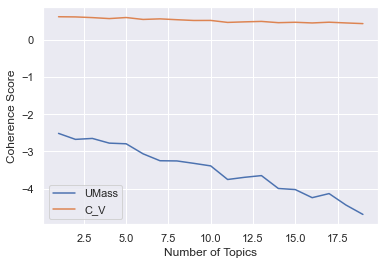

In [ ]:
dictionary, tokens, corpus = init_spacy_model(combined_tld_cmt_df['body'], truncate_dict=True)
combined_tld_cmt_df["tokens"] = tokens #not equal to the token-ids!!
compute_and_plot_ntopics_coherence(dictionary, tokens, corpus)


In [ ]:
import wordcloud as wd

cmt_wordcloud = wd.WordCloud(width=1600, height=800, max_font_size=200).generate(' '.join([item for sublist in combined_tld_cmt_df["tokens"] for item in sublist]))
print(cmt_wordcloud)
cmt_wordcloud.to_file("cmt_no_NOUNs_wordcloud.png")

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packag

In [ ]:
#Perform LDA topic modelling
lda_model = LdaMulticore(corpus=corpus, 
                         id2word=dictionary, 
                         iterations=100, 
                         num_topics=4, #3, 
                         workers = 2, 
                         passes=10,
                         random_state=100)

# The difference between iterations and passes is that iterations is during inference, and passes is during training.<

print(lda_model.print_topics(-1))

print(combined_tld_cmt_df["body"][0])
print(lda_model[corpus][973])

lda_display = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary)
pyLDAvis.display(lda_display)
pyLDAvis.save_html(lda_display, "data/lda_display.html")



[(0, '0.078*"quantum" + 0.013*"theory" + 0.013*"qubit" + 0.011*"physics" + 0.011*"computer" + 0.011*"new" + 0.010*"state" + 0.010*"system" + 0.009*"entanglement" + 0.009*"bit"'), (1, '0.025*"article" + 0.021*"read" + 0.020*"year" + 0.018*"think" + 0.015*"go" + 0.014*"sound" + 0.013*"know" + 0.013*"run" + 0.012*"science" + 0.012*"cool"'), (2, '0.062*"quantum" + 0.046*"computer" + 0.014*"computing" + 0.013*"know" + 0.012*"world" + 0.011*"thing" + 0.011*"time" + 0.011*"internet" + 0.010*"need" + 0.010*"problem"'), (3, '0.034*"time" + 0.019*"light" + 0.018*"particle" + 0.015*"photon" + 0.014*"universe" + 0.013*"state" + 0.012*"space" + 0.011*"matter" + 0.011*"speed" + 0.011*"travel"')]
The findings create a promising line of research for developing a fully functionalquantum computer. Whereas the bits of a normal computer are binary 1s or 0s, on or off the processing rate ofquantum computersis much faster because they utilize 'qubits,' which can be 1 and 0, on and off at the same time. One 

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\pyLDAvis\_prepare.py:244: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:

combined_tld_cmt_df['topic'] = [sorted(lda_model[corpus][text])[0][0] for text in range(len(combined_tld_cmt_df['body']))]
combined_tld_cmt_df.topic.value_counts()


#Identified topics: using 1st token type set

# - Topic 1 - Quantum phenomena/information
# - Topic 2 - Quantum computing/technology
# - Topic 3 - Physics
# - Topic 4 - General article responses \& scientific research


0    14317
1       84
3       35
2       26
Name: topic, dtype: int64

In [ ]:
print(corpus[973])
print(lda_model[corpus][973])
for cmt_i, cmt_body in combined_tld_cmt_df[combined_tld_cmt_df['topic'] == 2].iterrows():
    print("-------")
    print(cmt_i, cmt_body['body'])

[(41, 3), (53, 2), (58, 1), (78, 2), (99, 1), (121, 7), (176, 1), (186, 1), (390, 2), (429, 2), (571, 1), (572, 6), (646, 2), (837, 1), (906, 9)]
[(0, 0.9818324)]
-------
432 I work for a big software company, and we get approached by lots of these companies. They say that we need to prepare ourselves for the "post-quantum world". If quantum computing happens then *overnight* our encryption algorithms will become useless. Are we really prepared to take that risk with our customer data? No, we should be using their new encryption algorithms which will protect against being hacked by quantum computers.
They all give presentations talking about their patents, and PhD researchers, and mix a lot of truth about quantum computing in with a lot of fear. Their argument is that using their algorithms won't hurt, but doing nothing will.
It hard for developers to argue against as we're neither quantum computing experts nor cryptography experts.
-------
10026 Quantum computing is no threat to Bitco

### Incoporating engagement and sentiment scores

In [1]:
#!pip install seaborn spacy --user
#!python -m spacy download en_core_web_md
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import pandas as pd
import spacy

from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaMulticore
from gensim.models import CoherenceModel

from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.pipeline import Pipeline


def init_spacy_model(doc_str_list, min_token_freq, max_token_freq_frac, truncate_dict = False):
   # Our spaCy model:
   nlp = spacy.load('en_core_web_md')
   #nlp = en_core_web_md.load() # Tags I want to remove from the text

   #rm_token_types= ['SCONJ','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'AUX']   
   rm_token_types= ['SCONJ','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'AUX', 'VERB', 'ADV']
   
   tokens = []

   for doc_str in nlp.pipe(doc_str_list): #Make a stream of documents and seperate them into tokens
      # Lemmatize the text, take the lowercase form and remove punctuation & stopwords & tokens of specified types
      # is_alpha = only alphabetic characters
      # Lemmatize = reduce words to their root form
      
      proj_tok = [token.lemma_.lower() for token in doc_str if token.pos_ not in rm_token_types and not token.is_stop and token.is_alpha]
      tokens.append(proj_tok)
      

   # Apply the Dictionary Object from Gensim, which maps each word to their unique ID:
   dictionary = Dictionary(tokens)
   #print(dictionary.token2id)

   #Dictionary = token-tokenid map, corpus = tokenid frequency
   if truncate_dict:
      dictionary.filter_extremes(no_below=min_token_freq, no_above=max_token_freq_frac, keep_n=10000)
   
   corpus = [dictionary.doc2bow(doc) for doc in tokens] #Note: token_count is count within document, not the number of documents containing the token
   return dictionary, tokens, corpus




In [49]:
import itertools
import numpy as np
import sys
from collections import Counter
import networkx as nx
import plotly.graph_objects as go
import plotly.offline as py

from collections import defaultdict

annotated_art_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\annotated\\r_art_stratified_annotated.csv"

annotated_art_df = pd.read_csv(annotated_art_filepath, delimiter=";")


min_token_freq = 4 # min for token document occurrence
max_token_freq_frac = 1.0  # max for token document frequency fraction
edge_percentile_threshold = 80 # percentile threshold for edge weight

dictionary, tokens, corpus = init_spacy_model(annotated_art_df["body"], min_token_freq, max_token_freq_frac, truncate_dict = True)

# Create a dictionary with tokens as keys and lists of doc-in-corpus indices as values
token_occurences = defaultdict(list)
for doc_idx, doc in enumerate(corpus):
    unique_doc_token_bows = list(set(doc))
    
    for token_bow in unique_doc_token_bows:
        token_occurences[token_bow[0]].append({"doc_idx": doc_idx, "token_count_in_doc": token_bow[1]}) #token_bow[0] = token_id, token_bow[1] = token_count_in_doc

#ALthough infrequent tokens were readily removed earlier, we ensure this here again     
token_occurences = {k: v for k, v in token_occurences.items() if len(v) >= min_token_freq}

print(len(token_occurences.keys()))
print(token_occurences)


# Next the co-occurencies: Make a dictionary of token pairs and in which documents they co-occur
token_pair_occurs_and_weights = {}

for t1, t2 in itertools.combinations(token_occurences.keys(), 2):
    t1_doc_inds, t1_in_doc_counts, t2_doc_inds, t2_in_doc_counts = [], [], [], []
    for t1_occur_dict in token_occurences[t1]:
        t1_doc_inds.append(t1_occur_dict["doc_idx"])
        t1_in_doc_counts.append(t1_occur_dict["token_count_in_doc"])
    for t2_occur_dict in token_occurences[t2]:
        t2_doc_inds.append(t2_occur_dict["doc_idx"])
        t2_in_doc_counts.append(t2_occur_dict["token_count_in_doc"])
    
    co_occur_doc_inds = set(t1_doc_inds).intersection(set(t2_doc_inds))
    
    if len(co_occur_doc_inds) >= 1:
        #co_occur_jaccard = len(co_occur_doc_inds) / (len(set(t1_doc_inds))+len(set(t2_doc_inds)))
        asym_co_occur_jaccard = (len(co_occur_doc_inds) / (len(set(t1_doc_inds)))) + (len(co_occur_doc_inds) / (len(set(t2_doc_inds))))
        asym_co_occur_jaccard = (asym_co_occur_jaccard / 2)
        
        token_pair_occurs_and_weights[(t1, t2)] = {"co_occur_doc_inds" : list(co_occur_doc_inds), "score": asym_co_occur_jaccard} 

print(len(token_pair_occurs_and_weights.keys()))
#Print the weight values of all token pairs


# Filter out token pairs that would not yield so important edges; 
# That is, for each individual token, include the 20% most important token pairs in which it is involved.

print("\n Weights: ", sorted([x["score"] for x in token_pair_occurs_and_weights.values()], reverse=True))
#print("\n Percentile Threshold value: "len(percentile_threshold_value))

filtered_token_pair_occurs_and_weights = {}

for token, token_occor in token_occurences.items():
    token_pair_occur_and_weight_subset = {k: v for k, v in token_pair_occurs_and_weights.items() if token in k} #Select only those token pairs in which the token is involved
    percentile_threshold_value = np.percentile([x["score"] for x in token_pair_occur_and_weight_subset.values()], edge_percentile_threshold)
    token_pair_occur_and_weight_subset = {k: v for k, v in token_pair_occur_and_weight_subset.items() if v["score"] >= percentile_threshold_value} #Select only those token pairs which are in the top percentile of importance
    filtered_token_pair_occurs_and_weights.update(token_pair_occur_and_weight_subset)

print(len(filtered_token_pair_occurs_and_weights.keys()))


1095
{58: [{'doc_idx': 0, 'token_count_in_doc': 1}, {'doc_idx': 1, 'token_count_in_doc': 4}, {'doc_idx': 2, 'token_count_in_doc': 3}, {'doc_idx': 3, 'token_count_in_doc': 6}, {'doc_idx': 4, 'token_count_in_doc': 1}, {'doc_idx': 9, 'token_count_in_doc': 1}, {'doc_idx': 12, 'token_count_in_doc': 7}, {'doc_idx': 13, 'token_count_in_doc': 1}, {'doc_idx': 20, 'token_count_in_doc': 1}, {'doc_idx': 21, 'token_count_in_doc': 1}, {'doc_idx': 22, 'token_count_in_doc': 1}, {'doc_idx': 23, 'token_count_in_doc': 1}, {'doc_idx': 27, 'token_count_in_doc': 4}, {'doc_idx': 28, 'token_count_in_doc': 1}, {'doc_idx': 31, 'token_count_in_doc': 2}, {'doc_idx': 33, 'token_count_in_doc': 3}, {'doc_idx': 40, 'token_count_in_doc': 1}, {'doc_idx': 43, 'token_count_in_doc': 6}, {'doc_idx': 44, 'token_count_in_doc': 1}, {'doc_idx': 45, 'token_count_in_doc': 1}, {'doc_idx': 47, 'token_count_in_doc': 2}, {'doc_idx': 49, 'token_count_in_doc': 1}, {'doc_idx': 53, 'token_count_in_doc': 1}, {'doc_idx': 55, 'token_count_

In [51]:
G = nx.Graph()

# Add nodes
for token, token_occurs in token_occurences.items():
    doc_inds, in_doc_counts = zip(*token_occurs)
    G.add_node(token, size = len(doc_inds), plaintext = dictionary[token])
    
# Add edges
for token_pair, pair_occurs_and_weight in filtered_token_pair_occurs_and_weights.items():
    
    G.add_edge(token_pair[0], token_pair[1], weight = pair_occurs_and_weight["score"])

print(G.nodes(data=True))

[(58, {'size': 47, 'plaintext': 'mechanic'}), (45, {'size': 42, 'plaintext': 'future'}), (56, {'size': 26, 'plaintext': 'machine'}), (69, {'size': 18, 'plaintext': 'operation'}), (124, {'size': 6, 'plaintext': 'variety'}), (5, {'size': 17, 'plaintext': 'available'}), (42, {'size': 54, 'plaintext': 'experiment'}), (108, {'size': 7, 'plaintext': 'sycamore'}), (57, {'size': 4, 'plaintext': 'martinis'}), (82, {'size': 4, 'plaintext': 'prone'}), (112, {'size': 33, 'plaintext': 'technique'}), (122, {'size': 24, 'plaintext': 'useful'}), (46, {'size': 23, 'plaintext': 'google'}), (18, {'size': 13, 'plaintext': 'code'}), (97, {'size': 9, 'plaintext': 'sequence'}), (67, {'size': 6, 'plaintext': 'october'}), (110, {'size': 20, 'plaintext': 'task'}), (70, {'size': 53, 'plaintext': 'paper'}), (125, {'size': 16, 'plaintext': 'version'}), (9, {'size': 4, 'plaintext': 'caltech'}), (88, {'size': 12, 'plaintext': 'realm'}), (99, {'size': 38, 'plaintext': 'small'}), (48, {'size': 12, 'plaintext': 'hand'}

In [52]:


pos = nx.spring_layout(G, iterations=200)

edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    mode='lines'
)

node_x = [pos[node][0] for node in G.nodes()]
node_y = [pos[node][1] for node in G.nodes()]

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers+text',
    hovertext=[G.nodes[node]["plaintext"] for node in G.nodes()],
    text=[G.nodes[node]["plaintext"] for node in G.nodes()],
    textposition='middle center',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        reversescale=True,
        color="Yellow",
        size=[G.nodes[node]['size'] for node in G.nodes()],
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line_width=2
    )
)

fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='Word Co-occurrence Network graph',
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20, l=5, r=5, t=40),
                xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
)

py.iplot(fig)

In [26]:
import itertools
import numpy as np
import sys
from collections import Counter
import networkx as nx
import plotly.graph_objects as go
import plotly.offline as py

from collections import defaultdict

annotated_cmt_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\annotated\\r_cmt_stratified_annotated.csv"
annotated_cmt_df = pd.read_csv(annotated_cmt_filepath, delimiter=";")

min_token_freq = 6 # min for token document occurrence
max_token_freq_frac = 1.0  # max for token document frequency fraction
edge_percentile_threshold = 80 # percentile threshold for edge weight

dictionary, tokens, corpus = init_spacy_model(annotated_cmt_df["body"], min_token_freq, max_token_freq_frac, truncate_dict = True)

# Create a dictionary with tokens as keys and lists of doc-in-corpus indices as values
token_occurences = defaultdict(list)
for doc_idx, doc in enumerate(corpus):
    unique_doc_token_bows = list(set(doc))
    
    for token_bow in unique_doc_token_bows:
        token_occurences[token_bow].append(doc_idx)

#ALthough infrequent tokens were readily removed earlier, we ensure this here again     
token_occurences = {k: v for k, v in token_occurences.items() if len(v) >= min_token_freq}

print(len(token_occurences.keys()))
#print(token_occurences)

# Next the co-occurencies: Make a dictionary of token pairs and in which documents they co-occur
token_pair_occurs_and_weights = {}

for t1, t2 in itertools.combinations(token_occurences.keys(), 2):
    t1_doc_inds, t2_doc_inds = token_occurences[t1], token_occurences[t2]
    co_occur_doc_inds = set(t1_doc_inds).intersection(set(t2_doc_inds))
    
    if len(co_occur_doc_inds) >= 1:
        #co_occur_jaccard = len(co_occur_doc_inds) / (len(set(t1_doc_inds))+len(set(t2_doc_inds)))
        asym_co_occur_jaccard = (len(co_occur_doc_inds) / (len(set(t1_doc_inds)))) + (len(co_occur_doc_inds) / (len(set(t2_doc_inds))))
        
        token_pair_occurs_and_weights[(t1, t2)] = (list(co_occur_doc_inds), asym_co_occur_jaccard)

print(len(token_pair_occurs_and_weights.keys()))


# Filter out token pairs that would not yield so important edges; 
# That is, for each individual token, include the 20% most important token pairs in which it is involved.

#print([x[1] for x in token_pair_occurs_and_weights.values()])
#percentile_threshold_value = [np.percentile(x[1], edge_percentile_threshold) for x in token_pair_occurs_and_weights.values()]
#print(len(percentile_threshold_value))

filtered_token_pair_occurs_and_weights = {}

for token_bow, token_occor in token_occurences.items():
    token_pair_occur_and_weight_subset = {k: v for k, v in token_pair_occurs_and_weights.items() if token_bow in k} #Select only those token pairs in which the token is involved
    percentile_threshold_value = np.percentile([x[1] for x in token_pair_occur_and_weight_subset.values()], edge_percentile_threshold)
    token_pair_occur_and_weight_subset = {k: v for k, v in token_pair_occur_and_weight_subset.items() if v[1] >= percentile_threshold_value} #Select only those token pairs which are in the top percentile of importance
    filtered_token_pair_occurs_and_weights.update(token_pair_occur_and_weight_subset)

print(len(filtered_token_pair_occurs_and_weights.keys()))

698
61832
17401


In [27]:
G = nx.Graph()

# Add nodes
for token_bow, token_occor in token_occurences.items():
    assert len(token_occor) > 0
    G.add_node(token_bow[0], size = len(token_occor), plaintext = dictionary[token_bow[0]])
    
# Add edges
for token_pair, (pair_occurs, pair_weight) in filtered_token_pair_occurs_and_weights.items():
    #assert
    G.add_edge(token_pair[0][0], token_pair[1][0], weight = pair_weight)

print(G.nodes(data=True))



pos = nx.spring_layout(G, iterations=200)

edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    mode='lines'
)

node_x = [pos[node][0] for node in G.nodes()]
node_y = [pos[node][1] for node in G.nodes()]

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers+text',
    hovertext=[G.nodes[node]["plaintext"] for node in G.nodes()],
    text=[G.nodes[node]["plaintext"] for node in G.nodes()],
    textposition='middle center',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        reversescale=True,
        color="Yellow",
        size=[G.nodes[node]['size'] for node in G.nodes()],
        colorbar=dict(
            thickness=15,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line_width=2
    )
)

fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='Word Co-occurrence Network graph',
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20, l=5, r=5, t=40),
                xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
)

py.iplot(fig)

[(0, {'size': 34, 'plaintext': 'amazing'}), (11, {'size': 22, 'plaintext': 'study'}), (12, {'size': 13, 'plaintext': 'system'}), (7, {'size': 17, 'plaintext': 'new'}), (13, {'size': 21, 'plaintext': 'thing'}), (8, {'size': 58, 'plaintext': 'physicist'}), (3, {'size': 10, 'plaintext': 'living'}), (6, {'size': 21, 'plaintext': 'molecule'}), (1, {'size': 25, 'plaintext': 'author'}), (14, {'size': 13, 'plaintext': 'time'}), (10, {'size': 30, 'plaintext': 'state'}), (5, {'size': 12, 'plaintext': 'million'}), (9, {'size': 47, 'plaintext': 'quantum'}), (17, {'size': 236, 'plaintext': 'year'}), (4, {'size': 55, 'plaintext': 'man'}), (16, {'size': 50, 'plaintext': 'well'}), (18, {'size': 37, 'plaintext': 'actual'}), (19, {'size': 60, 'plaintext': 'paper'}), (28, {'size': 10, 'plaintext': 'price'}), (23, {'size': 27, 'plaintext': 'claim'}), (33, {'size': 12, 'plaintext': 'stock'}), (29, {'size': 21, 'plaintext': 'public'}), (24, {'size': 30, 'plaintext': 'decade'}), (27, {'size': 23, 'plaintext'

##### Shetl Optimized:

In [36]:

shtetl_optim_art_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\destilled\\shtetl_optim_articles.csv"
shtetl_optim_art_df = pd.read_csv(shtetl_optim_art_filepath, ) #sep=";"

# Our spaCy model:
nlp = spacy.load('en_core_web_md')
#nlp = en_core_web_md.load() # Tags I want to remove from the text

rm_token_types= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'VERB', 'AUX']

tokens = []

for art_body in nlp.pipe(shtetl_optim_art_df['body']): #Make a stream of documents and seperate them into tokens
   # Lemmatize the text, take the lowercase form and remove punctuation & stopwords & tokens of specified types
   # is_alpha = only alphabetic characters
   # Lemmatize = reduce words to their root form
   
   proj_tok = [token.lemma_.lower() for token in art_body if token.pos_ not in rm_token_types and not token.is_stop and token.is_alpha]
   tokens.append(proj_tok)
   
shtetl_optim_art_df["tokens"] = tokens #not equal to the token-ids!!

# Apply the Dictionary Object from Gensim, which maps each word to their unique ID:
dictionary = Dictionary(shtetl_optim_art_df['tokens'])
print(dictionary.token2id)

#Dictionary = token-tokenid map, corpus = tokenid frequency
#dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=1000)
corpus = [dictionary.doc2bow(doc) for doc in shtetl_optim_art_df['tokens']]

import wordcloud as wd

shtetl_optim_art_wordcloud = wd.WordCloud(width=1600, height=800, max_font_size=200).generate(' '.join([item for sublist in shtetl_optim_art_df["tokens"] for item in sublist]))
print(shtetl_optim_art_wordcloud)
shtetl_optim_art_wordcloud.to_file("shtetl_optim_art_wordcloud.png")


{'able': 0, 'actual': 1, 'advance': 2, 'algorithm': 3, 'ambiguous': 4, 'approach': 5, 'ashley': 6, 'author': 7, 'benefit': 8, 'birthday': 9, 'boulebnane': 10, 'bruce': 11, 'cargo': 12, 'classical': 13, 'clean': 14, 'comment': 15, 'complete': 16, 'computer': 17, 'conclusion': 18, 'convergence': 19, 'covid': 20, 'crucial': 21, 'cryptosystem': 22, 'cult': 23, 'day': 24, 'decisive': 25, 'detailed': 26, 'duty': 27, 'error': 28, 'exception': 29, 'experience': 30, 'expert': 31, 'exploration': 32, 'exponential': 33, 'factoring': 34, 'fault': 35, 'gate': 36, 'hard': 37, 'heuristic': 38, 'hour': 39, 'huge': 40, 'hundred': 41, 'hype': 42, 'idea': 43, 'impression': 44, 'insight': 45, 'integer': 46, 'irrelevancy': 47, 'kid': 48, 'laptop': 49, 'lattice': 50, 'long': 51, 'magic': 52, 'method': 53, 'miracle': 54, 'montanaro': 55, 'near': 56, 'new': 57, 'nisq': 58, 'non': 59, 'number': 60, 'optimization': 61, 'page': 62, 'paper': 63, 'past': 64, 'pattern': 65, 'people': 66, 'point': 67, 'possible': 68,

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packag

In [64]:

shtetl_optim_cmt_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\destilled\\shtetl_optim_comments.csv"
shtetl_optim_cmt_df = pd.read_csv(shtetl_optim_cmt_filepath, ) #sep=";"

print(len(shtetl_optim_cmt_df["body"].values))
print(type(shtetl_optim_cmt_df["body"].values[0]) == str)

shtetl_optim_cmt_df = shtetl_optim_cmt_df[shtetl_optim_cmt_df.apply(lambda x: type(x["body"]) == str, axis=1)]

print(len(shtetl_optim_cmt_df["body"].values))

##---- Extra preprocessing needed for comments ----##
import re

def preprocess_comment_text(comment_bodies):
    #Remove links/urls
    rm_urls = lambda s: re.sub(r'https?:\/\/(www\.)?[-a-zA-Z0-9@:%._\+~#=]{1,256}\.[a-zA-Z0-9()]{1,6}\b([-a-zA-Z0-9()@:%_\+.~#?&//=]*)', r'', s)

    #Remove emojis and other non-ascii characters
    rm_emojis = lambda s: re.sub(r'[^\x00-\x7F]+', r'',  rm_urls(s)) # 

    #Remove multiple newlines
    rm_multinewlines = lambda s: re.sub(r'(\n+\s*\n+)+' , r'\n', rm_emojis(s)) #

    #Remove multiple spaces
    rm_multispaces = lambda s: re.sub(r'(\s\s+)' , r' ', rm_multinewlines(s))
    
    #Perform all the operations above in one go
    return np.array([rm_multispaces(cmt_body) for cmt_body in comment_bodies])

shtetl_optim_cmt_df['body'] = preprocess_comment_text(shtetl_optim_cmt_df['body'].values)


# Delete empty comments which have not at least one non-special character (i.e. letter or number) in their body text
shtetl_optim_cmt_df = shtetl_optim_cmt_df[shtetl_optim_cmt_df['body'].str.contains(r'[a-zA-Z0-9]')]

# Delete comments by bots or moderators, pre-surveyed: "AutoModerator", "FuturologyBot", "CivilServantBot", "SEP-Bot", "AmputatorBot", "OtherAMPBot"
bot_user_list = ["AutoModerator", "FuturologyBot", "CivilServantBot", "SEP-Bot", "AmputatorBot", "OtherAMPBot"]
shtetl_optim_cmt_df = shtetl_optim_cmt_df[~shtetl_optim_cmt_df['username'].isin(bot_user_list)]

## ---------------   

# Our spaCy model:
nlp = spacy.load('en_core_web_md')
#nlp = en_core_web_md.load() # Tags I want to remove from the text

rm_token_types= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'VERB', 'AUX']

tokens = []

for art_body in nlp.pipe(shtetl_optim_cmt_df['body']): #Make a stream of documents and seperate them into tokens
   # Lemmatize the text, take the lowercase form and remove punctuation & stopwords & tokens of specified types
   # is_alpha = only alphabetic characters
   # Lemmatize = reduce words to their root form
   
   proj_tok = [token.lemma_.lower() for token in art_body if token.pos_ not in rm_token_types and not token.is_stop and token.is_alpha]
   tokens.append(proj_tok)
   
shtetl_optim_cmt_df["tokens"] = tokens #not equal to the token-ids!!

# Apply the Dictionary Object from Gensim, which maps each word to their unique ID:
dictionary = Dictionary(shtetl_optim_cmt_df['tokens'])
print(dictionary.token2id)

#Dictionary = token-tokenid map, corpus = tokenid frequency
#dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=1000)
corpus = [dictionary.doc2bow(doc) for doc in shtetl_optim_cmt_df['tokens']]

import wordcloud as wd

shtetl_optim_cmt_wordcloud = wd.WordCloud(width=1600, height=800, max_font_size=200).generate(' '.join([item for sublist in shtetl_optim_cmt_df["tokens"] for item in sublist]))
print(shtetl_optim_cmt_wordcloud)
shtetl_optim_cmt_wordcloud.to_file("shtetl_optim_cmt_wordcloud.png")


14018
True
14011
{'algorithm': 0, 'angle': 1, 'author': 2, 'babai': 3, 'babais': 4, 'claim': 5, 'community': 6, 'cvp': 7, 'example': 8, 'hard': 9, 'important': 10, 'low': 11, 'lucky': 12, 'method': 13, 'new': 14, 'paper': 15, 'people': 16, 'plain': 17, 'progress': 18, 'qfft': 19, 'quantum': 20, 'related': 21, 'resource': 22, 'schnorr': 23, 'schnorrs': 24, 'shor': 25, 'study': 26, 'svp': 27, 'vanilla': 28, 'way': 29, 'advantage': 30, 'al': 31, 'annoying': 32, 'arxiv': 33, 'case': 34, 'combinatorial': 35, 'criticism': 36, 'curious': 37, 'discussion': 38, 'et': 39, 'factoring': 40, 'mario': 41, 'optimization': 42, 'pirnay': 43, 'problem': 44, 'sorry': 45, 'szegedy': 46, 'announcement': 47, 'background': 48, 'breakthrough': 49, 'enthusiasm': 50, 'follow': 51, 'naught': 52, 'necessary': 53, 'time': 54, 'brandolinis': 55, 'clue': 56, 'code': 57, 'cycle': 58, 'fancy': 59, 'fidelity': 60, 'fud': 61, 'gate': 62, 'hardware': 63, 'ibm': 64, 'integer': 65, 'large': 66, 'law': 67, 'like': 68, 'mini

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packag

### COmments with replies:

In [66]:

cmt_with_rep_filepath = "S:\\Sync\\University\\2023_MRP_1\\MRP1_WorkDir\\data\\all_request_comments_subreddit_posthostselect.csv"
cmt_with_rep_df = pd.read_csv(cmt_with_rep_filepath, ) #sep=";"

print(len(cmt_with_rep_df["body"].values))
print(type(cmt_with_rep_df["body"].values[0]) == str)

cmt_with_rep_df = cmt_with_rep_df[cmt_with_rep_df.apply(lambda x: type(x["body"]) == str, axis=1)]

print(len(cmt_with_rep_df["body"].values))

##---- Extra preprocessing needed for comments ----##
import re

def preprocess_comment_text(comment_bodies):
    #Remove links/urls
    rm_urls = lambda s: re.sub(r'https?:\/\/(www\.)?[-a-zA-Z0-9@:%._\+~#=]{1,256}\.[a-zA-Z0-9()]{1,6}\b([-a-zA-Z0-9()@:%_\+.~#?&//=]*)', r'', s)

    #Remove emojis and other non-ascii characters
    rm_emojis = lambda s: re.sub(r'[^\x00-\x7F]+', r'',  rm_urls(s)) # 

    #Remove multiple newlines
    rm_multinewlines = lambda s: re.sub(r'(\n+\s*\n+)+' , r'\n', rm_emojis(s)) #

    #Remove multiple spaces
    rm_multispaces = lambda s: re.sub(r'(\s\s+)' , r' ', rm_multinewlines(s))
    
    #Perform all the operations above in one go
    return np.array([rm_multispaces(cmt_body) for cmt_body in comment_bodies])

cmt_with_rep_df['body'] = preprocess_comment_text(cmt_with_rep_df['body'].values)


# Delete empty comments which have not at least one non-special character (i.e. letter or number) in their body text
cmt_with_rep_df = cmt_with_rep_df[cmt_with_rep_df['body'].str.contains(r'[a-zA-Z0-9]')]

# Delete comments by bots or moderators, pre-surveyed: "AutoModerator", "FuturologyBot", "CivilServantBot", "SEP-Bot", "AmputatorBot", "OtherAMPBot"
bot_user_list = ["AutoModerator", "FuturologyBot", "CivilServantBot", "SEP-Bot", "AmputatorBot", "OtherAMPBot"]
cmt_with_rep_df = cmt_with_rep_df[~cmt_with_rep_df['author_name'].isin(bot_user_list)]

## ---------------   

# Our spaCy model:
nlp = spacy.load('en_core_web_md')
#nlp = en_core_web_md.load() # Tags I want to remove from the text

rm_token_types= ['ADV','PRON','CCONJ','PUNCT','PART','DET','ADP','SPACE', 'NUM', 'SYM', 'VERB', 'AUX']

tokens = []

for art_body in nlp.pipe(cmt_with_rep_df['body']): #Make a stream of documents and seperate them into tokens
   # Lemmatize the text, take the lowercase form and remove punctuation & stopwords & tokens of specified types
   # is_alpha = only alphabetic characters
   # Lemmatize = reduce words to their root form
   
   proj_tok = [token.lemma_.lower() for token in art_body if token.pos_ not in rm_token_types and not token.is_stop and token.is_alpha]
   tokens.append(proj_tok)
   
cmt_with_rep_df["tokens"] = tokens #not equal to the token-ids!!

# Apply the Dictionary Object from Gensim, which maps each word to their unique ID:
dictionary = Dictionary(cmt_with_rep_df['tokens'])
print(dictionary.token2id)

#Dictionary = token-tokenid map, corpus = tokenid frequency
#dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=1000)
corpus = [dictionary.doc2bow(doc) for doc in cmt_with_rep_df['tokens']]

import wordcloud as wd

cmt_with_rep_wordcloud = wd.WordCloud(width=1600, height=800, max_font_size=200).generate(' '.join([item for sublist in cmt_with_rep_df["tokens"] for item in sublist]))
print(cmt_with_rep_wordcloud)
cmt_with_rep_wordcloud.to_file("cmt_with_rep_wordcloud.png")


159757
True
159744
{'paper': 0, 'source': 1, 'clear': 2, 'correct': 3, 'matter': 4, 'movement': 5, 'heh': 6, 'hey': 7, 'internet': 8, 'modem': 9, 'night': 10, 'phone': 11, 'quantum': 12, 'till': 13, 'uplink': 14, 'article': 15, 'crosspost': 16, 'fly': 17, 'flyman': 18, 'interested': 19, 'answer': 20, 'e': 21, 'effect': 22, 'fan': 23, 'fiction': 24, 'good': 25, 'mass': 26, 'practical': 27, 'thank': 28, 'use': 29, 'lake': 30, 'reiden': 31, 'relevant': 32, 'entanglement': 33, 'ping': 34, 'shit': 35, 'teleportation': 36, 'crystal': 37, 'entangled': 38, 'light': 39, 'magnet': 40, 'photon': 41, 'ultra': 42, 'violet': 43, 'application': 44, 'communication': 45, 'current': 46, 'model': 47, 'physical': 48, 'understanding': 49, 'communicator': 50, 'experiment': 51, 'interesting': 52, 'stupid': 53, 'thread': 54, 'title': 55, 'business': 56, 'comment': 57, 'major': 58, 'section': 59, 'summary': 60, 'course': 61, 'cryptography': 62, 'essential': 63, 'final': 64, 'handout': 65, 'information': 66, 'k

c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:106: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  self.colormap = plt.cm.get_cmap(colormap)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packages\wordcloud\wordcloud.py:508: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  box_size = draw.textsize(word, font=transposed_font)
c:\Users\trothe\AppData\Local\Programs\Python\Python310\lib\site-packag